# Sonification of Octahedral Tilt Angles Part One (continuous data)

## Overview

This notebook explores the sonification of molecular dynamics data using the [Strauss](https://www.audiouniverse.org/research/strauss) software package. 

Molecular dynamics applies classical mechanics (Newton's laws of motion) to predict the motion of atoms in a material. In the dataset we explore here the forces which "drive" the molecular dynamics simulations are calculated using quantum chemistry. This provides us with high-accuracy predictions of the material dynamics. 

We will use sonification to listen to the dynamics (vibrations) of the material; we will hear how they sing.

The material under study is BaZrS$_3$, a potential new photovoltaic material which is at an early stage of development. BaZrS$_3$ forms in the perovskite structure; a structural model is displayed below.

<img src="../assets/img/perovskite.png" width="250" align="center">

All of the data used in this repo has been published as part of a [recent study](https://arxiv.org/pdf/2411.14289). 

## **1. Setup:**



You will need to install `strauss` if you have not done so already.

Make plots appear in-line by default

In [1]:
%matplotlib inline

Import the modules we need...

In [3]:
# strauss imports
from strauss.sonification import Sonification
from strauss.sources import Events, Objects
from strauss import channels
from strauss.score import Score
from strauss.generator import Sampler, Synthesizer, Spectralizer
from strauss import sources as Sources
import strauss

# other standard scientific Python modules
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# modules to display in-notebook
import IPython.display as ipd
from IPython.display import display, Markdown, Latex, Image

# set figures to be a decent size by default
import matplotlib
font = {'family' : 'sans-serif',
        'weight' : 'normal',
        'size'   : 18}
matplotlib.rc('font', **font)
matplotlib.rc('figure', **{'figsize':[14.0, 7.0]})

## Phonon mode amplitude mapping (a multivariate time-series)

The datasets are parsed from molecular dynamics simulations of the chalocogenide perovskite BaZrS$_3$. These are heating simulations, with temperature increasing linearly with time.

In [6]:
file = '../data/df_heating_tric_Tstart1_Tstop1200_P0_size8_nsteps200_dump500_run-000.csv'
data_table = pd.read_csv(file)
print(data_table.head())

   time      temp      Epot        Mx        My        Mz        Rx        Ry  \
0   0.0  0.998263 -2.046939  0.000215 -0.000049  0.390492  0.318198  0.318193   
1   0.5  1.007351 -2.046933  0.000012 -0.000023  0.390421  0.318148  0.318159   
2   1.0  1.021132 -2.046932 -0.000209 -0.000025  0.390388  0.318142  0.318182   
3   1.5  1.012238 -2.046929 -0.000089 -0.000137  0.390336  0.318142  0.318131   
4   2.0  1.005549 -2.046927  0.000174 -0.000172  0.390259  0.318136  0.318197   

         Rz      alat      blat      clat  
0 -0.000035  5.048901  4.955879  5.016878  
1 -0.000037  5.048899  4.955922  5.016931  
2  0.000080  5.048855  4.955964  5.016959  
3 -0.000023  5.048795  4.955986  5.016968  
4  0.000022  5.048802  4.956012  5.016952  


In addition, we see that we have ten other time-/temperature- dependent quantities: The potential energy (aka ***Epot***, in eV), the projection of the M-point phonon mode along each axis (aka ***Mx, My, Mz***, fractional value), the projection of the R-point phonon mode along each axis (aka ***Rx, Ry, Rz***, fractional value) and the lattice vectors (aka ***alat, blat, clat***, in Angstrom).

The M-point distortion corresponds to an in-phase octahedral tilt of PbI$_6$ octahedra:

<img src="../assets/img/M-mode.gif" width="250" align="center">

The R-point distortion corresponds to an out-of-phase octahedral tilt of PbI$_6$ octahedra:

<img src="../assets/img/R-mode.gif" width="250" align="center">

We can plot the amplitude of the M-mode octahedral tilts as a function of temperature (measured in Kelvin).

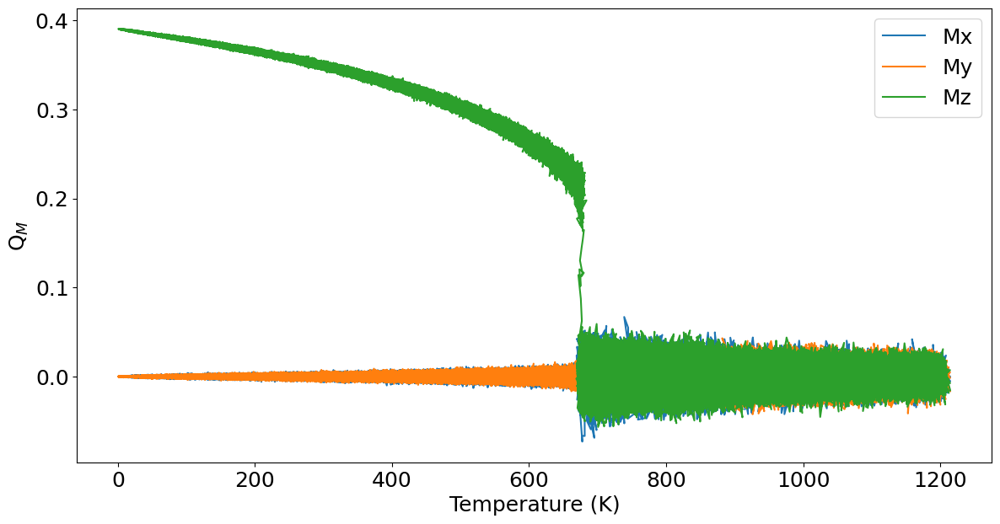

In [7]:
time = data_table.columns[0]
temp = data_table.columns[1]
Epot = data_table.columns[2]
Mx = data_table.columns[3]
My = data_table.columns[4]
Mz = data_table.columns[5]
Rx = data_table.columns[6]
Ry = data_table.columns[7]
Rz = data_table.columns[8]
alat = data_table.columns[9]
blat = data_table.columns[10]
clat = data_table.columns[11]
plt.plot(data_table[temp], data_table[Mx],label='Mx')
plt.plot(data_table[temp], data_table[My],label='My')
plt.plot(data_table[temp], data_table[Mz],label='Mz')
plt.legend()
plt.xlabel('Temperature (K)')
plt.ylabel(r'Q$_M$')
plt.show()

When representing this data visually it is common practice to smooth over a given time frame. See, for example, the same data as plotted here in Fig. 2b of [Octahedral tilt-driven phase transitions in BaZrS3 chalcogenide perovskite](https://arxiv.org/pdf/2411.14289). For sonification purposes we will retain the full complexity (thermal disorder) of the data.

First we will try sonifying these by mapping one of the M-mode amplitudes to `pitch_shift`, one to `cutoff` and one to `volume`.

100%|█████████████████████████████████████████████| 2/2 [00:01<00:00,  1.57it/s]


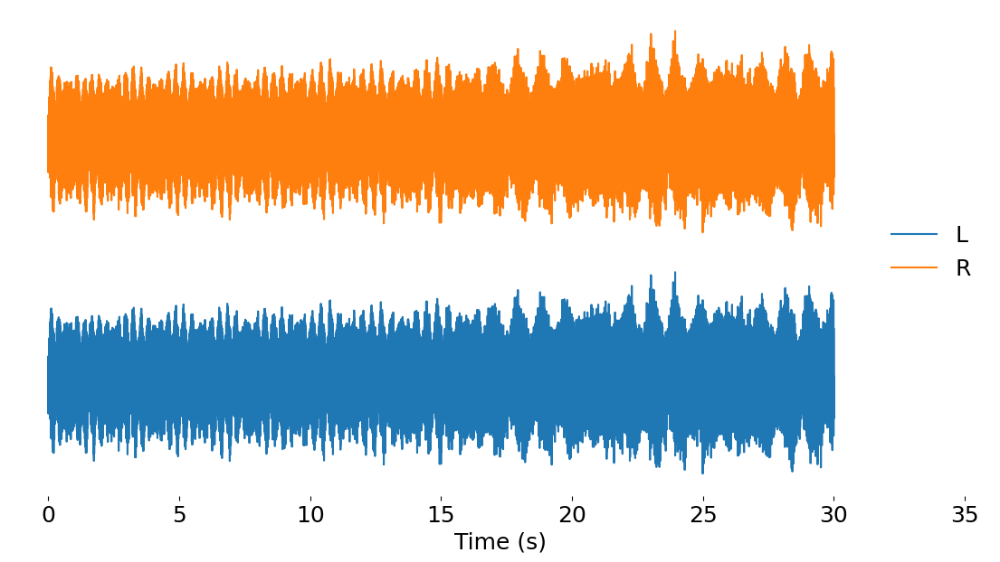

In [8]:
# some strauss setup can happen outside the loop...
length = 30.0
generator = Synthesizer()
generator.load_preset('default')
generator.modify_preset({'filter':'on'})
notes = [["A2","C3", "E3"]]
score =  Score(notes, length)

lims = {'time_evo': ('0','100'),
        'pitch_shift': ('0','100'),
        'cutoff': ('0','100'),
        'volume':('0','100')}

data_input = np.genfromtxt(file, delimiter=',')[1:]
temp = data_input[:,1]
Mx = data_input[:,3]
My = data_input[:,4]
Mz = data_input[:,5]

data = {'pitch':[0,1],
        'time_evo':[temp]*2,
        'pitch_shift':[Mz]*2,
        'cutoff':[Mx]*2,
        'volume':[My]*2}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
plims = {'cutoff': (0.3,0.9)}
sources.apply_mapping_functions(map_lims=lims, param_lims=plims)

soni = Sonification(score, sources, generator)
soni.render()
dobj = soni.notebook_display()

## Exhaustive search for optimum mapping parameters

Now let's consider all possible combinations of the 8 evolvable parameters implemented in strauss.

For this we will consider only 2 properties being sonified at once (not including the time variable) as, due to crystal symmetry, Mx and My display similar behaviour.

For 2 properties there are 28 possible mapping combinations $\left(\frac{8!}{2!(8-2)!} = 28\right)$.

Some combinations might work better than others; an exhaustive search means cannot miss the most effective combination.

Note that the cell output has been deleted as the resulting sonifications take up a relatively large amount of memory (more than Github can handle....).

In [ ]:
# A list of some 'evolvable' mappings
some_mappings = ["pitch_shift",
                 "cutoff",
                 "volume",
                 "phi",
                 "volume_lfo/amount",
                 "volume_lfo/freq_shift",
                 "pitch_lfo/amount",
                 "pitch_lfo/freq_shift"]

def make_sonification(idx_Mx, idx_Mz):
    chosen = [some_mappings[idx_Mx],some_mappings[idx_Mz]]
    
    # use a stereo system to allow 'phi' mapping (low pan left and high pan right)
    system = "stereo"
    
    # some strauss setup can happen outside the loop...
    generator = Synthesizer()
    
    generator = Synthesizer()
    generator.modify_preset({'filter':'on',
                             "pitch_hi":-1, "pitch_lo": 1,
                             "pitch_lfo": {"use": "on",
                                           "amount":1*("pitch_lfo/freq_shift" in chosen),
                                           "freq":3*5**("pitch_lfo/freq_shift" not in chosen),
                                           "phase":0.25},
                             "volume_lfo": {"use": "on",
                                            "amount":1*("volume_lfo/freq_shift" in chosen),
                                            "freq":3*5**("volume_lfo/freq_shift" not in chosen),
                                            "phase":0}
                            })
    
    
    notes = [["A2", "E3"]]
    score =  Score(notes, length)
    
    lims = {'time_evo': ('0','100'),
            'pitch_shift': ('0','100'),
            'cutoff': ('0','100'),
            "volume": ('0','100'),
            "phi": (-0.5,1.5),
            "volume_lfo/amount": ('0','100'),
            "volume_lfo/freq_shift": ('0','100'),
            "pitch_lfo/amount": ('0','100'),
            "pitch_lfo/freq_shift": ('0','100')}
    
    display(Markdown(f"## Mapping Mx to <mark>***`{some_mappings[idx_Mx]}`***</mark> and Mz to <mark>***`{some_mappings[idx_Mz]}`***</mark>:"))
    
    # get data
    data = np.genfromtxt(file, delimiter=',')[1:]
    temp = data[:,1]
    Mx = data[:,3]
    Mz = data[:,5]
    
    data = {'pitch':[0,1],
          'time_evo':[temp]*2,
          'theta':[0.5]*2,
          some_mappings[idx_Mx]:[(Mx - Mx.min())/(Mx.max()-Mx.min())]*2,
          some_mappings[idx_Mz]:[(Mz - Mz.min())/(Mz.max()-Mz.min())]*2}
    
    # set up source
    sources = Objects(data.keys())
    sources.fromdict(data)
    plims = {'cutoff': (0.4,1)}
    sources.apply_mapping_functions(map_lims=lims, param_lims=plims)
    
    soni = Sonification(score, sources, generator, system)
    soni.render()
    dobj = soni.notebook_display()
    
    # change back in case cells are run out of order...
    generator.load_preset('pitch_mapper')

indices = list(itertools.combinations(range(0,8),r=2))

for i,j in indices:
    make_sonification(i,j)

## Data smoothing

Smoothing is commonly applied to data in order to simplify patterns and highlight particular trends. 

In [9]:
def smooth_data(data, window_size):
    series = pd.Series(data)
    new_data = series.rolling(window_size, win_type='boxcar', center=True, min_periods=1).mean()
    return np.array(new_data)

In [23]:
Mx_smooth = smooth_data(data_table[Mx], 2000)
My_smooth = smooth_data(data_table[My], 2000)
Mz_smooth = smooth_data(data_table[Mz], 2000)
temp_smooth = smooth_data(data_table[temp],2000)

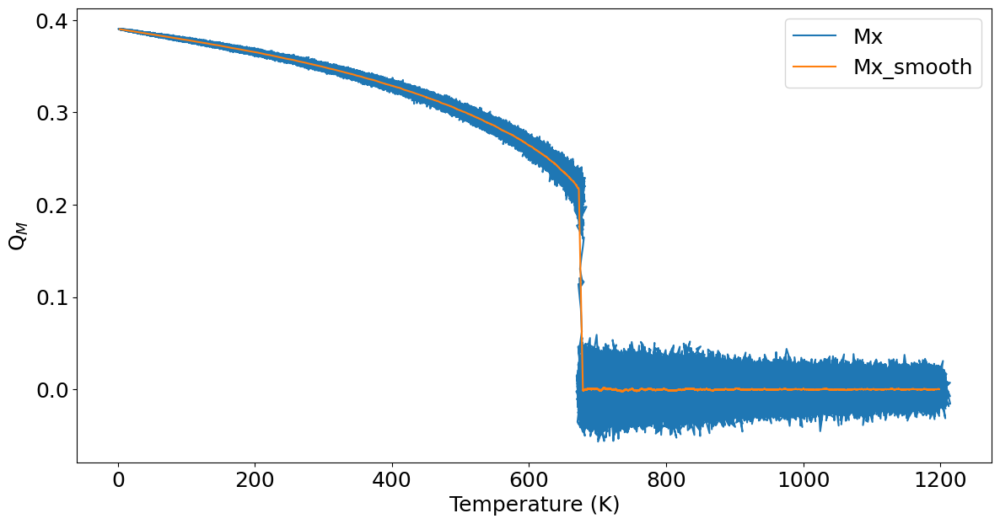

In [24]:
plt.plot(data_table[temp], data_table[Mz], label='Mx')
plt.plot(temp_smooth, Mz_smooth,label='Mx_smooth')
plt.legend()
plt.xlabel('Temperature (K)')
plt.ylabel(r'Q$_M$')
plt.show()

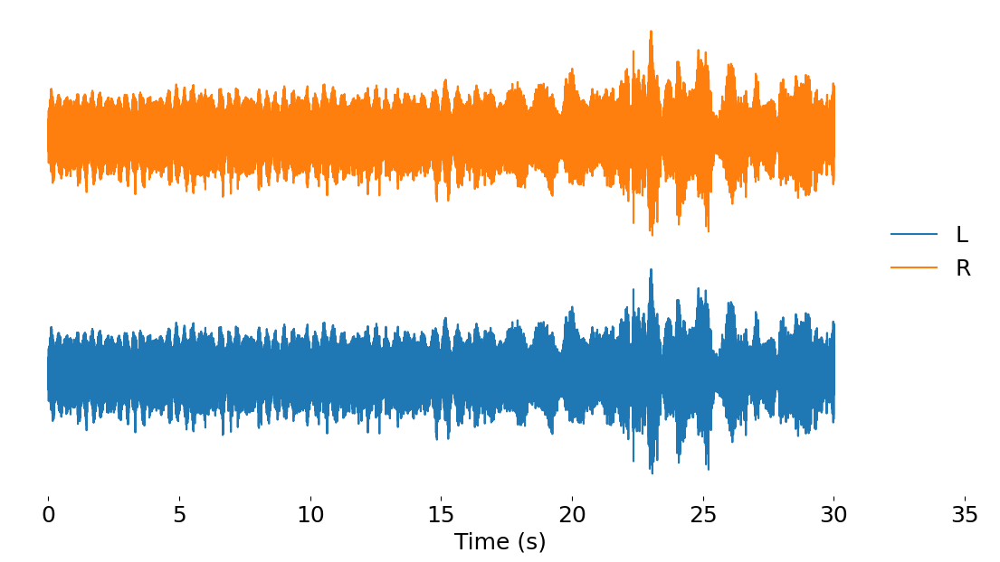

In [31]:
data = {'pitch':[0,1],
        'time_evo':[temp_smooth]*2,
        'pitch_shift':[Mz_smooth]*2,
        'cutoff':[Mx_smooth]*2,
        'volume':[My_smooth]*2}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
plims = {'cutoff': (0.3,0.9)}
sources.apply_mapping_functions(map_lims=lims, param_lims=plims)

soni = Sonification(score, sources, generator)
soni.render()
dobj = soni.notebook_display()

Now applying the `pitch_mapper` synthesiser preset for comparison.

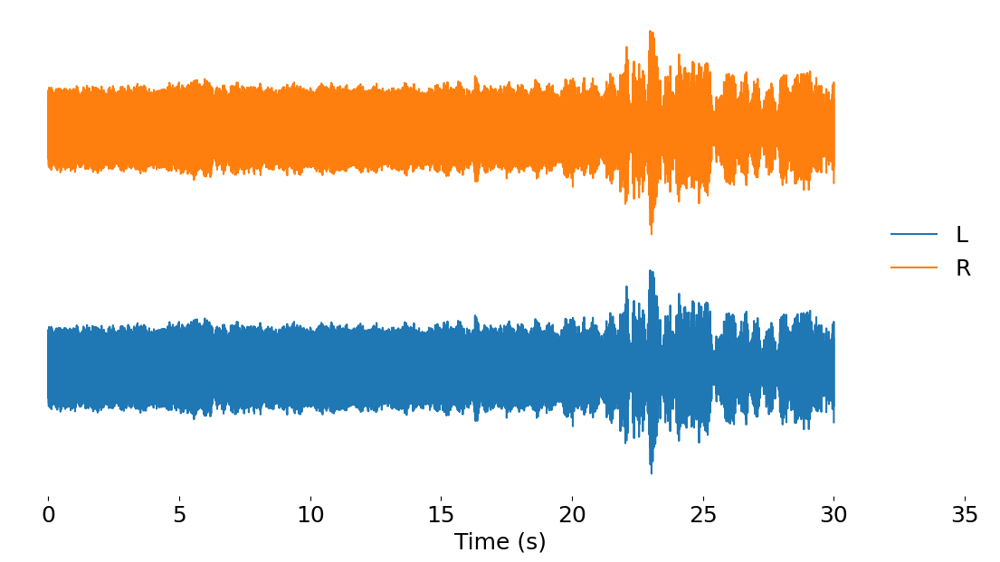

In [32]:
generator.load_preset('pitch_mapper')

data = {'pitch':[0,1],
        'time_evo':[temp_smooth]*2,
        'pitch_shift':[Mz_smooth]*2,
        'cutoff':[Mx_smooth]*2,
        'volume':[My_smooth]*2}

# set up source
sources = Objects(data.keys())
sources.fromdict(data)
plims = {'cutoff': (0.3,0.9)}
sources.apply_mapping_functions(map_lims=lims, param_lims=plims)

soni = Sonification(score, sources, generator)
soni.render()
dobj = soni.notebook_display()

In [Part Two](./Sonification_of_Octahedral_Tilts_Part_Two.ipynb) we sonify the same dataset, but now treating it as discrete data.